<a href="https://www.kaggle.com/code/orestasdulinskas/song-recommendation-system?scriptVersionId=168590443" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

![Spotify logo](https://i.pcmag.com/imagery/reviews/042FW7hC9vrGnoDea9LArXI-35.fit_scale.size_760x427.v1674253030.png)

# Spotify Song Recommendation System
---

## Background
With the exponential growth of music streaming platforms, users often face the challenge of discovering new songs tailored to their preferences. By leveraging machine learning techniques, this project seeks to address this issue by creating a personalized recommendation system. The dataset includes various features such as track name, artist, genre, and musical attributes like danceability, energy, and tempo. Through K-means clustering, songs with similar characteristics will be grouped together, allowing users to explore and discover music that aligns with their tastes.

## Objective
The objective of this project is to develop a robust and effective song recommendation system using K-means clustering with Spotify data. The goal is to cluster songs based on their musical attributes, such as danceability, energy, and acousticness, in order to group similar songs together. This clustering approach will enable the creation of tailored recommendations, allowing users to explore new music that closely matches their preferences and tastes. Ultimately, the objective is to enhance user satisfaction and engagement by providing accurate and relevant song suggestions, thereby improving the overall music listening experience for users.

## Data
The Spotify dataset consists of various attributes related to songs, artists, and musical characteristics. Here is a brief description of each column:

* **track_name**: The name of the song.
* **artists**: The name of the artist(s) who performed the song.
* **artist_genres**: The genres associated with the artist(s).
* **explicit**: A binary indicator (0 or 1) indicating whether the song contains explicit content.
* **album_name**: The name of the album to which the song belongs.
* **release_year**: The year in which the song was released.
* **danceability**: A measure of how suitable a track is for dancing, ranging from 0 to 1.
* **energy**: Represents the intensity and activity of the song, ranging from 0 to 1.
* **key**: The key the track is in (e.g., C, D, E, etc.).
* **loudness**: The overall loudness of the track in decibels (dB).
* **mode**: Indicates whether the track is in major (1) or minor (0) key.
* **speechiness**: Detects the presence of spoken words in the song, ranging from 0 to 1.
* **acousticness**: Represents the likelihood of the song being acoustic, ranging from 0 to 1.
* **instrumentalness**: Indicates the likelihood of the song containing no vocals, ranging from 0 to 1.
* **liveness**: Measures the presence of a live audience in the recording, ranging from 0 to 1.
* **valence**: Describes the musical positiveness conveyed by a track, ranging from 0 to 1.
* **tempo**: The overall estimated tempo of the track in beats per minute (BPM).
* **time_signature**: Represents the number of beats in each bar of the song's music.

This dataset provides a comprehensive overview of songs and their characteristics, which will be utilized to build an efficient song recommendation system using K-means clustering.

# Data Cleaning
---

In [1]:
# Import dataset
import pandas as pd
import warnings
warnings.filterwarnings("ignore")

path = r'/kaggle/input/spotify-dataset-2023/spotify_data_12_20_2023.csv'
df = pd.read_csv(path, low_memory=False)
df.columns

Index(['album_id', 'album_name', 'album_popularity', 'album_type', 'artists',
       'artist_0', 'artist_1', 'artist_2', 'artist_3', 'artist_4', 'artist_id',
       'duration_sec', 'label', 'release_date', 'total_tracks', 'track_id',
       'track_name', 'track_number', 'artist_genres', 'artist_popularity',
       'followers', 'name', 'genre_0', 'genre_1', 'genre_2', 'genre_3',
       'genre_4', 'acousticness', 'analysis_url', 'danceability',
       'duration_ms', 'energy', 'instrumentalness', 'key', 'liveness',
       'loudness', 'mode', 'speechiness', 'tempo', 'time_signature',
       'track_href', 'type', 'uri', 'valence', 'explicit', 'track_popularity',
       'release_year', 'release_month', 'rn'],
      dtype='object')

In [2]:
# Selecting relevant features
df = df[['track_name', 'artists', 'artist_genres', 'explicit','album_name', 'release_year', 'danceability',
           'energy', 'key','loudness', 'mode', 'speechiness', 'acousticness',
           'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']]

In [3]:
# Removing symbols from artists names
df['artists'] = df['artists'].str.replace(r"['\[\]]", '', regex=True)

In [4]:
# Processing artists genres to fit the purpose of the project
import ast

list_of_lists = [ast.literal_eval(s) for s in df['artist_genres']]
df['artist_genres'] = [sublist[0] if sublist else None for sublist in list_of_lists]
df['artist_genres'].fillna("unknown", inplace=True)

In [5]:
# Renaming column
df.rename(columns={'track_name':'name'}, inplace=True)

In [6]:
df.info() # Summary of DataFrame information

print('\nNumber of unique values in each column')
for i in df.columns:
    print(f'{i} - {df[i].nunique()}')

print('\nNumber of missing values in each column\n', df.isnull().sum())

print('\nNumber of duplicated rows\n', df.duplicated().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 375141 entries, 0 to 375140
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              375136 non-null  object 
 1   artists           375141 non-null  object 
 2   artist_genres     375141 non-null  object 
 3   explicit          375131 non-null  object 
 4   album_name        375140 non-null  object 
 5   release_year      375119 non-null  float64
 6   danceability      374364 non-null  float64
 7   energy            374364 non-null  float64
 8   key               374364 non-null  float64
 9   loudness          374364 non-null  float64
 10  mode              374364 non-null  float64
 11  speechiness       374364 non-null  float64
 12  acousticness      374364 non-null  float64
 13  instrumentalness  374364 non-null  float64
 14  liveness          374364 non-null  float64
 15  valence           374364 non-null  float64
 16  tempo             37

In [7]:
# Dropping rows with empty values
df = df.dropna()
print('Length of the dataset:', len(df))

Length of the dataset: 374327


In [8]:
# Setting value type to integer
df['explicit'] = df['explicit'].astype(int)
df['release_year'] = df['release_year'].astype(int)

In [9]:
# Applying Label Encoder to artist genre values
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
df['artist_genres_encoded'] = label_encoder.fit_transform(df['artist_genres'])

In [10]:
df.describe()

,explicit,release_year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_genres_encoded
count,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000,374327.000000
mean,0.155933,2013.397778,0.572332,0.524810,5.230373,-11.249055,0.637990,0.116589,0.385677,0.264414,0.196693,0.453956,118.650957,3.874145,1959.460547
std,0.362792,11.818953,0.190818,0.264169,3.581466,6.548168,0.480582,0.162887,0.359063,0.379240,0.175038,0.266350,30.516678,0.520693,1058.001083
min,0.000000,1886.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2010.000000,0.452000,0.319000,2.000000,-14.061000,0.000000,0.036400,0.038900,0.000000,0.097400,0.231000,94.989000,4.000000,865.000000
50%,0.000000,2017.000000,0.598000,0.539000,5.000000,-9.527000,1.000000,0.050100,0.268000,0.000729,0.124000,0.440000,119.422000,4.000000,2412.000000
75%,0.000000,2022.000000,0.714000,0.736000,8.000000,-6.681000,1.000000,0.109000,0.739000,0.698000,0.235000,0.664000,138.005000,4.000000,2905.000000
max,1.000000,2023.000000,0.999000,1.000000,11.000000,3.744000,1.000000,0.970000,0.996000,1.000000,1.000000,1.000000,249.428000,5.000000,3008.000000


In [11]:
# Reseting dataframe index
df.reset_index(drop=True, inplace=True)

# Exploratory Data Analysis (EDA)
---

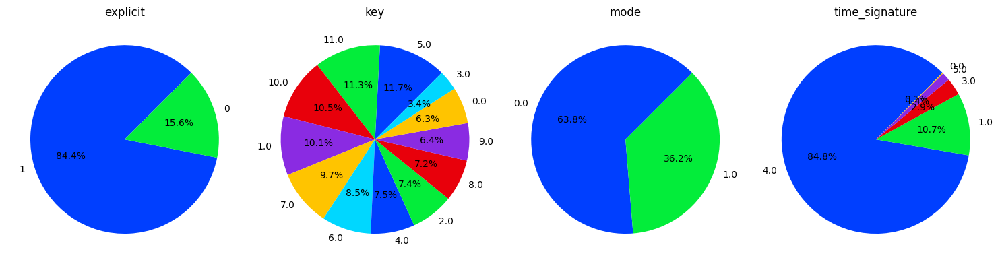

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-v0_8-bright')
colors = sns.color_palette('bright')

fig, axes = plt.subplots(1, 4, figsize=(15, 4))  # 1 row, 4 columns

for i, name in enumerate(['explicit', 'key', 'mode', 'time_signature']):
    axes[i].pie(df[name].value_counts(), labels=df[name].unique(), autopct='%1.1f%%', startangle=45)
    axes[i].set_title(f'{name}')

# Display the plot
plt.tight_layout()
plt.show()

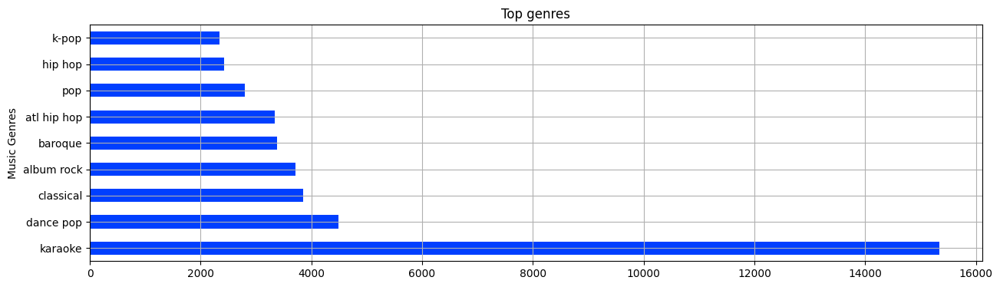

In [13]:
#Top 10 genres based on frequency
plt.figure(figsize=(15, 4))
df['artist_genres'].value_counts().head(10).iloc[1:].plot(kind='barh',title='Top genres')
plt.ylabel('Music Genres')
plt.grid(True)
plt.show()

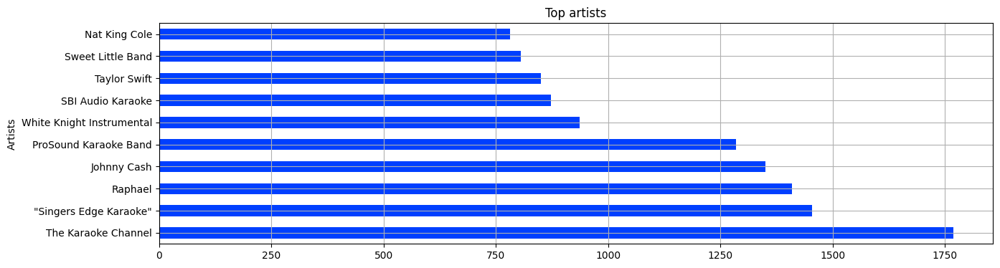

In [14]:
#Top 10 artists based on frequency 
plt.figure(figsize=(15, 4))
df['artists'].value_counts().head(10).plot(kind='barh',title='Top artists')
plt.ylabel('Artists')
plt.grid(True)
plt.show()

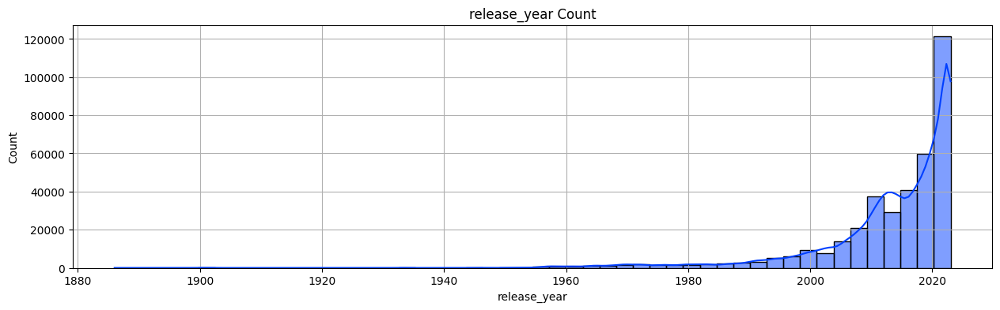

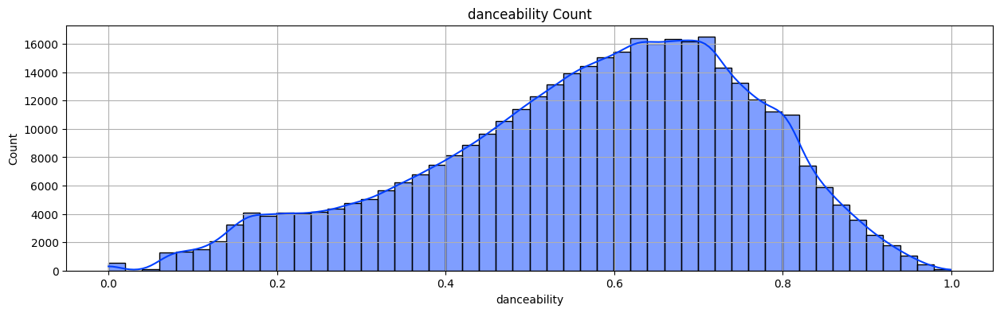

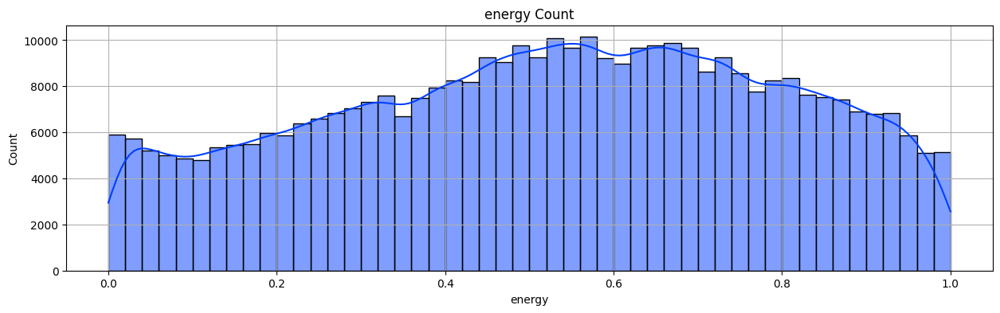

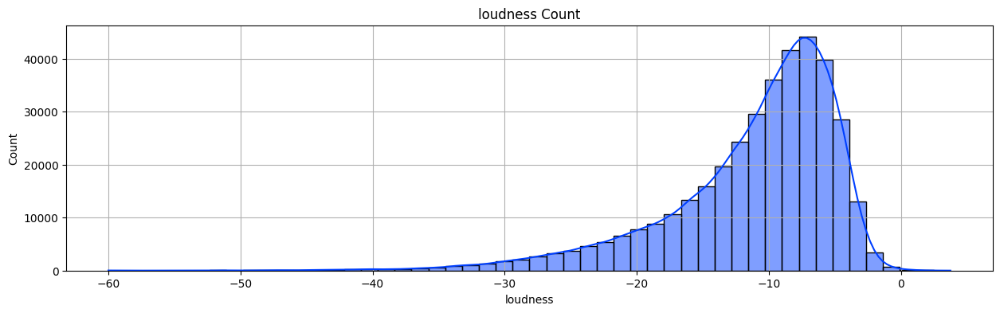

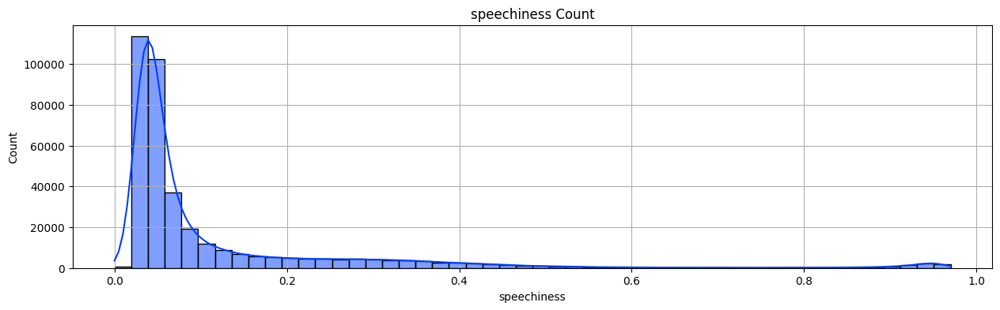

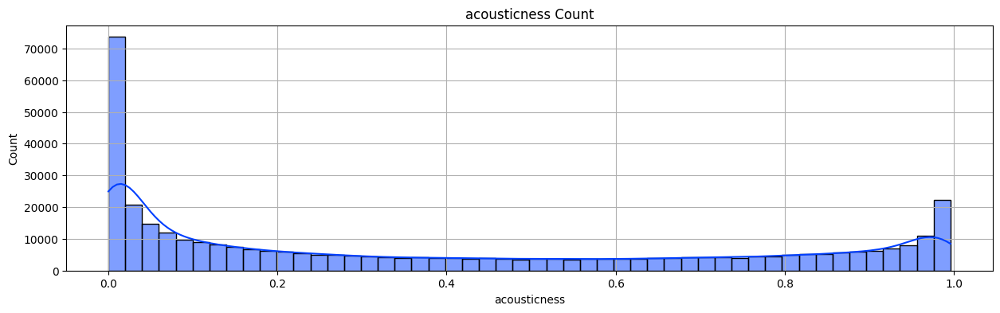

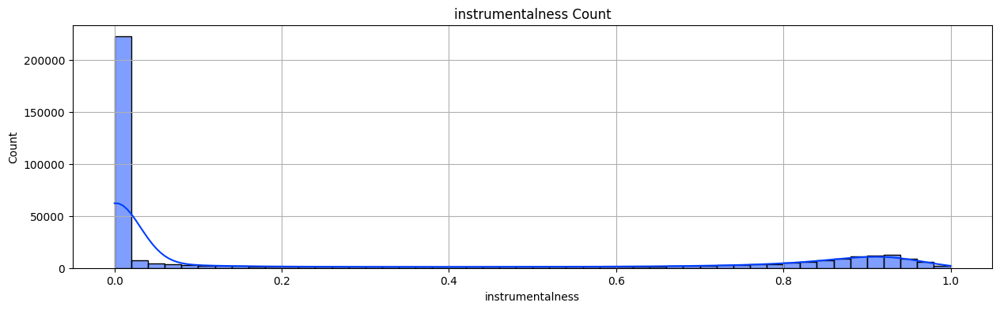

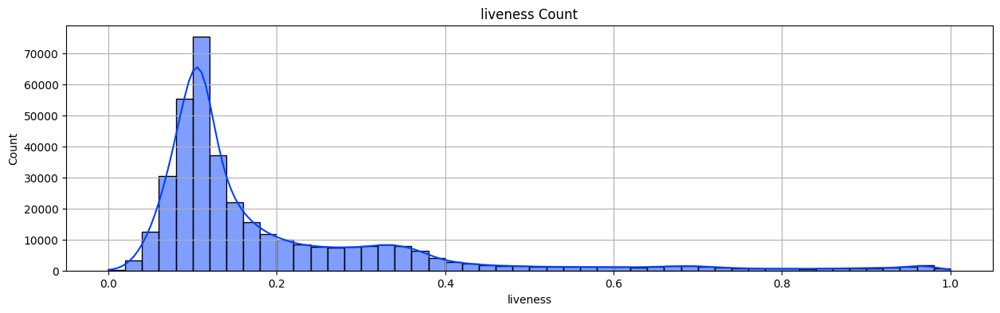

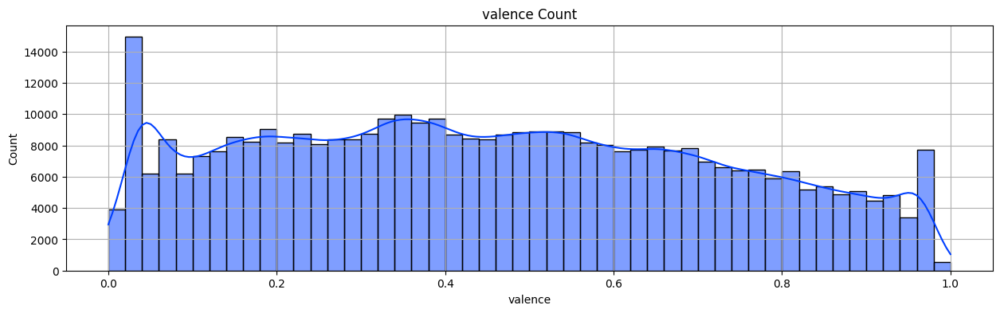

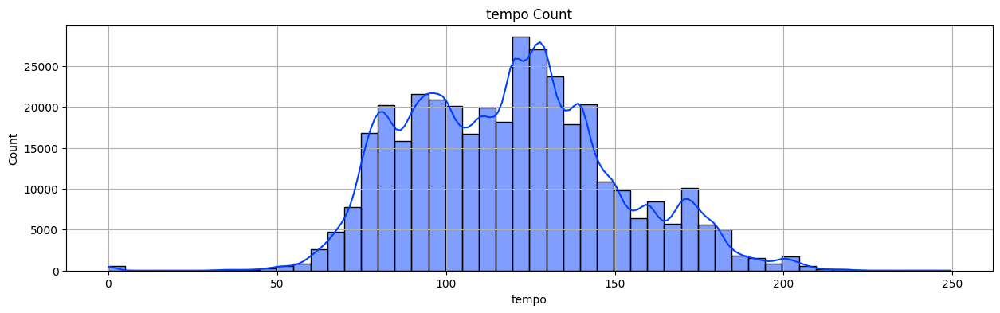

In [15]:
# Histogram Analysis of Continuous Variables
for i in df.drop(['explicit', 'key', 'mode', 'time_signature', 'name', 'artists', 'album_name', 'artist_genres', 'artist_genres_encoded'],axis=1):
    fig, ax = plt.subplots(figsize=(15, 4))
    fig = sns.histplot(data=df, x=i, bins=50, kde=True)
    fig.set_title(f'{i} Count')
    fig.grid(True)
    plt.show()

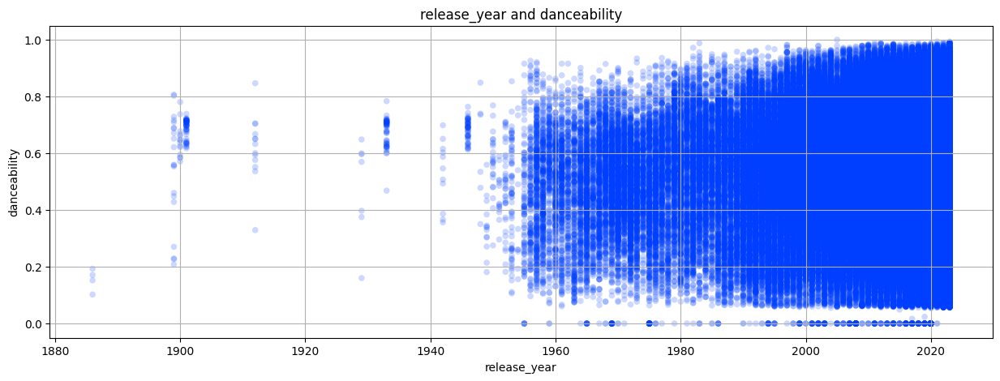

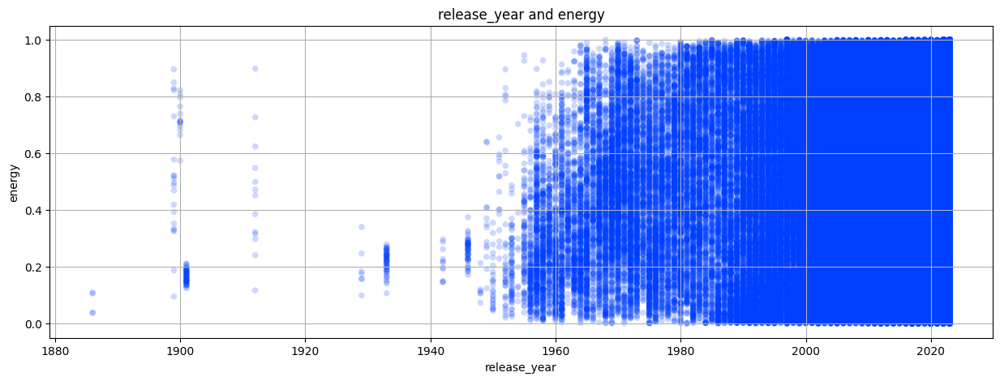

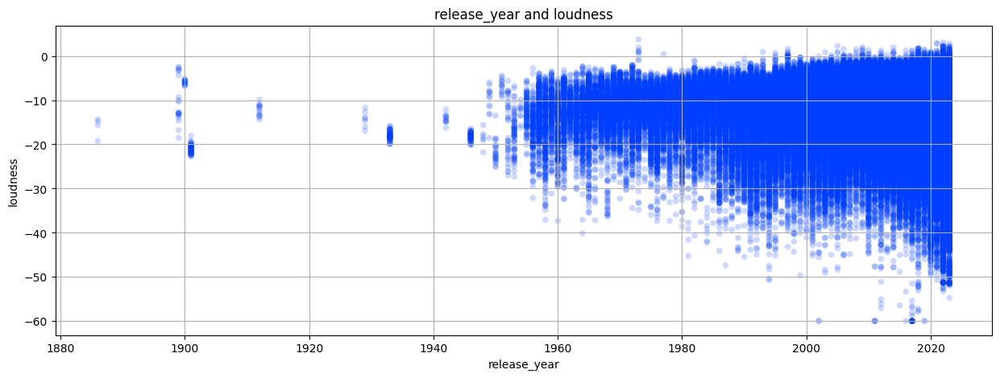

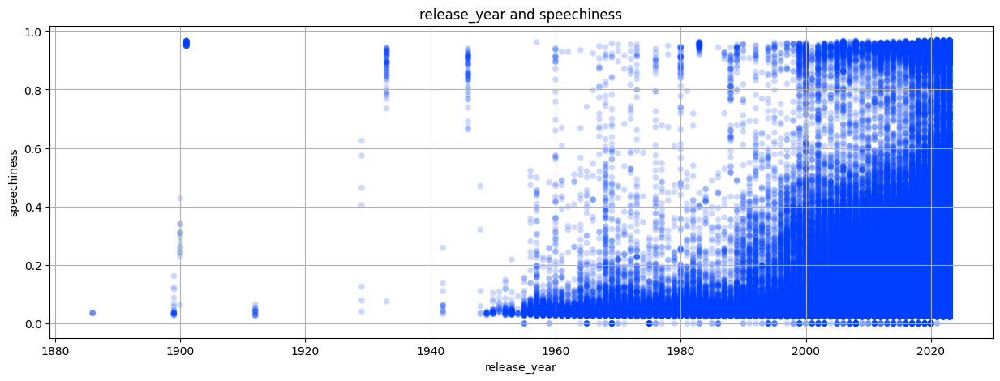

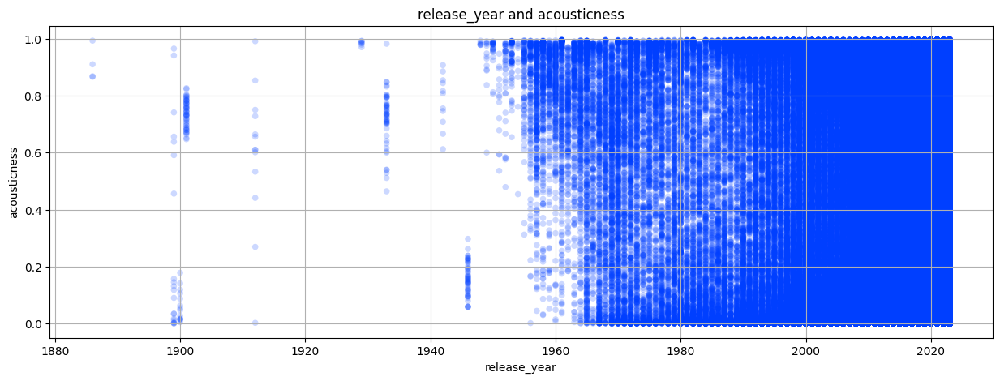

...

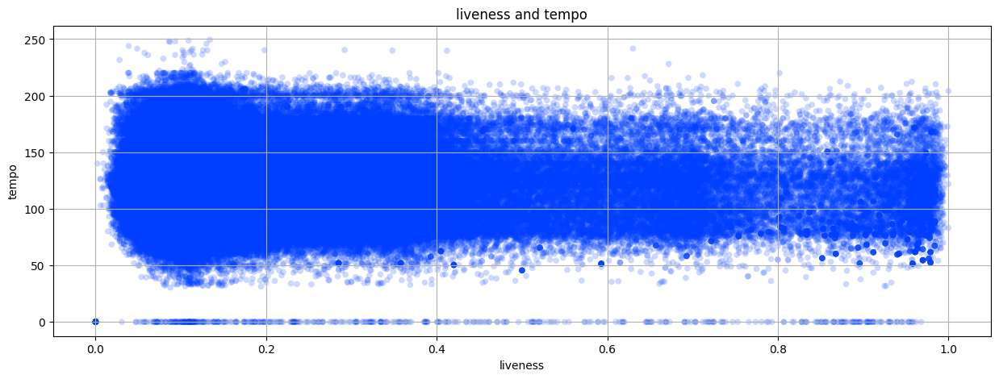

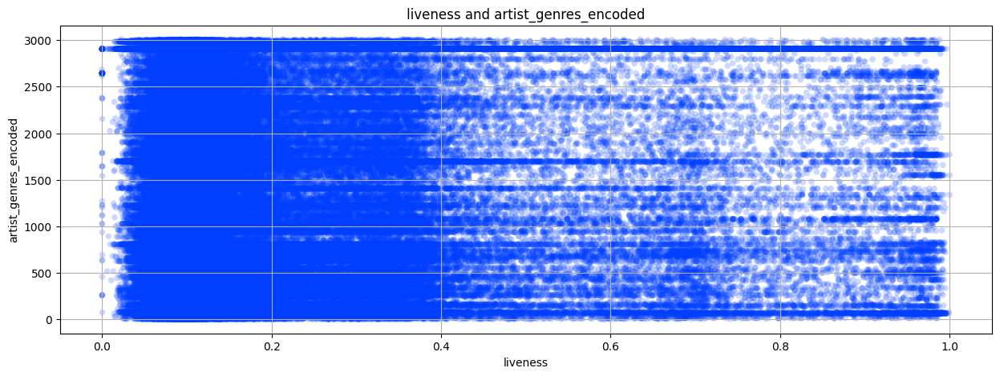

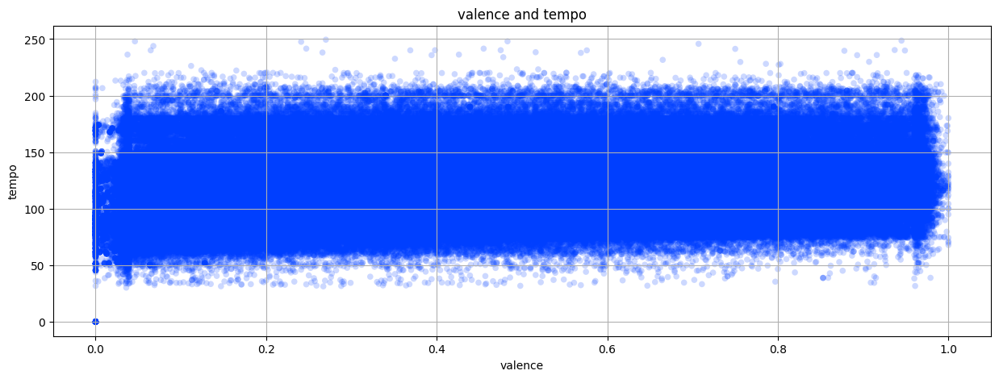

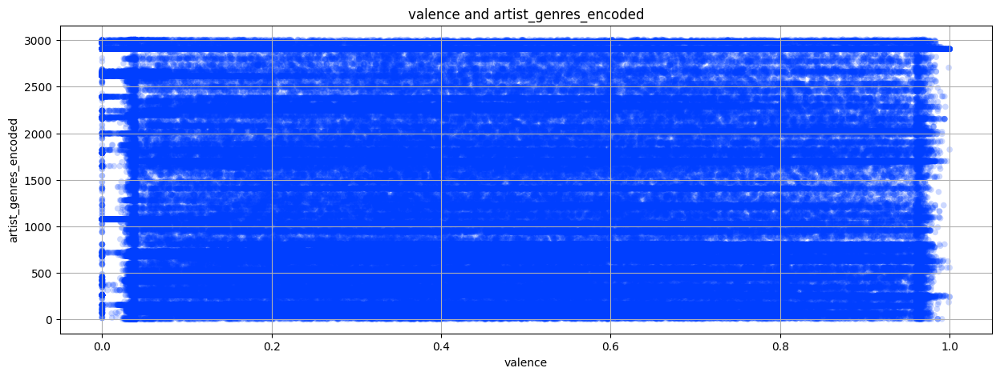

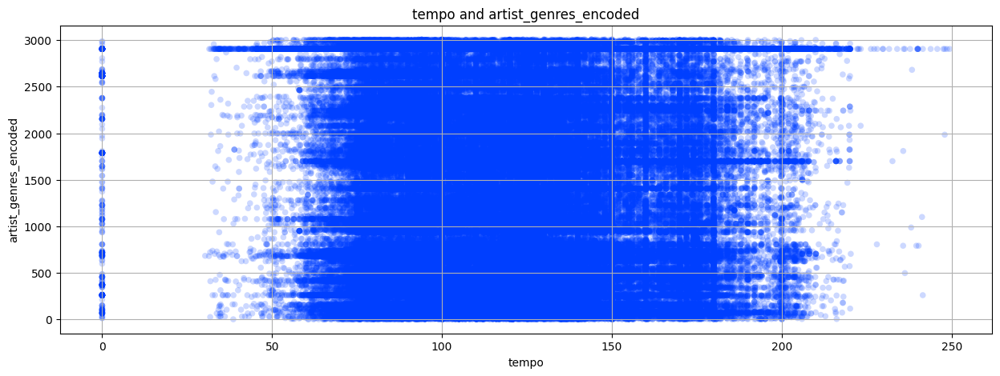

In [16]:
# Pairwise Scatter Plot Analysis of Music Attributes
from itertools import combinations
import matplotlib.patches as mpatches

for i, j in combinations(['release_year', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'artist_genres_encoded'], 2):
    fig, ax = plt.subplots(figsize=(15, 5))
    plt.scatter(df[i],df[j], alpha=0.2, s=30, edgecolor="none")
    plt.xlabel(i)
    plt.ylabel(j)
    plt.title(f'{i} and {j}')
    plt.grid(True)
    plt.show()

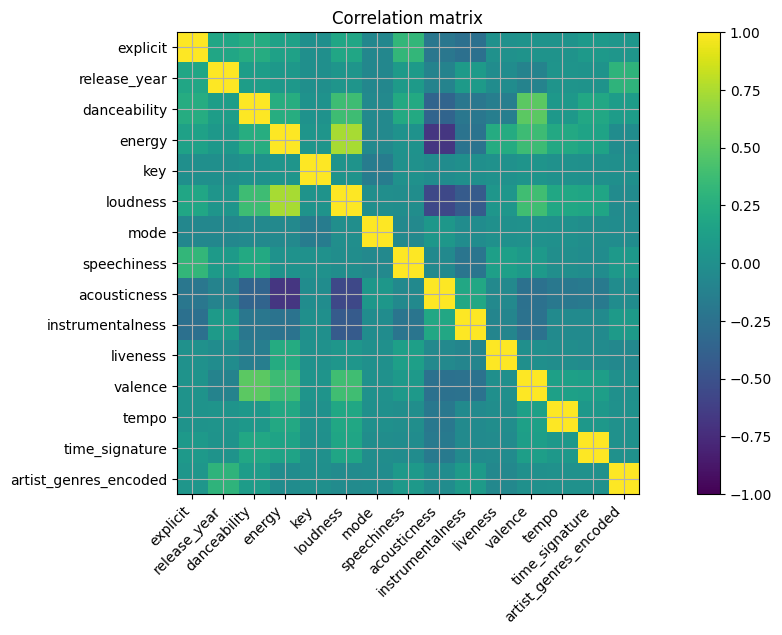

In [17]:
# Correlation matrix
import numpy as np

plt.figure(figsize=(15,6))
plt.imshow(df[df.select_dtypes(np.number).columns].corr(), vmin=-1, vmax=1)
plt.xticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns, rotation=45, ha='right')
plt.yticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns)
plt.title('Correlation matrix')
plt.grid(True)
plt.colorbar()

plt.show()

# Pre-processing
---

In [18]:
# Selecting training features (numerate columns)
features = df.select_dtypes(np.number).columns

In [19]:
# Rescaling data using Standard Scaler
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df_scaled = scaler.fit_transform(df[features])

df_scaled = pd.DataFrame(df_scaled, columns=features)

In [20]:
df_scaled.head()

,explicit,release_year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_genres_encoded
0,2.326586,0.812444,0.260292,0.110499,-0.064324,0.266343,-1.327538,1.825873,-0.989181,-0.697217,1.115802,-0.270155,-1.510814,0.241707,0.893705
1,2.326586,0.812444,1.711935,0.666962,1.610970,0.773814,-1.327538,0.131448,-1.042932,-0.697221,-0.249621,-0.979750,-0.559366,0.241707,0.893705
2,2.326586,0.812444,1.098786,0.723744,1.331754,0.451128,-1.327538,1.629418,-0.847144,-0.697221,-0.403874,1.430620,-0.618088,0.241707,0.893705
3,2.326586,0.812444,1.947762,0.216492,-1.181186,0.312157,0.753274,1.107584,-1.062622,-0.697221,-0.574695,-0.758236,-0.447001,0.241707,0.893705
4,2.326586,0.812444,-0.237564,0.439834,-0.064324,0.011615,-1.327538,3.765866,-1.038197,-0.697221,-0.627255,-0.277664,1.771887,0.241707,0.893705


# Clustering
---

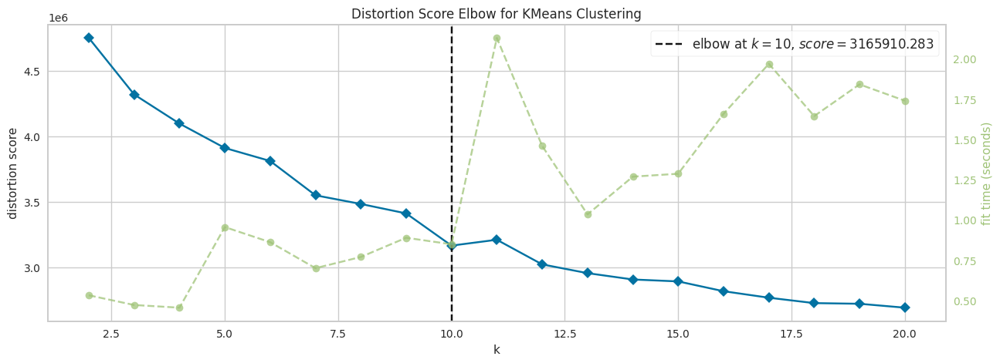

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [21]:
# Elbow Method to determine the number of clusters to be formed
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

plt.figure(figsize=(15,5)) 
Elbow_M = KElbowVisualizer(KMeans(n_init='auto'), k=20)
Elbow_M.fit(df_scaled)
Elbow_M.show()

In [22]:
# Using KMeans model 11 clusters
model = KMeans(n_clusters=11, n_init='auto')
model.fit(df_scaled)

df_scaled["Cluster"] = model.labels_

In [23]:
# Visualizing the Clusters with PCA
import plotly.express as px 
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
embedding = pca.fit_transform(df_scaled)
projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
projection['title'] = df['name']
projection['genre'] = df['artist_genres']
projection['cluster'] = df_scaled['Cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genre'])
fig.show()

# Setting up Recommendation System
---

In [24]:
# Re-adding string features (Name, Artist, Genre, Album)
df_scaled = df_scaled.join(df[df.drop(features, axis=1).columns])

In [25]:
# Re-adding Year feature
df_scaled['release_year'] = df['release_year']

In [26]:
df_scaled.head()

,explicit,release_year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_genres_encoded,Cluster,name,artists,artist_genres,album_name
0,2.326586,2023,0.260292,0.110499,-0.064324,0.266343,-1.327538,1.825873,-0.989181,-0.697217,1.115802,-0.270155,-1.510814,0.241707,0.893705,10,Intro,AB,unknown,Son Of Tabu
1,2.326586,2023,1.711935,0.666962,1.610970,0.773814,-1.327538,0.131448,-1.042932,-0.697221,-0.249621,-0.979750,-0.559366,0.241707,0.893705,10,Play It Cool,"AB, 22nd Jim",unknown,Son Of Tabu
2,2.326586,2023,1.098786,0.723744,1.331754,0.451128,-1.327538,1.629418,-0.847144,-0.697221,-0.403874,1.430620,-0.618088,0.241707,0.893705,10,3 Peat,"AB, Veeze",unknown,Son Of Tabu
3,2.326586,2023,1.947762,0.216492,-1.181186,0.312157,0.753274,1.107584,-1.062622,-0.697221,-0.574695,-0.758236,-0.447001,0.241707,0.893705,4,Affiliated,AB,unknown,Son Of Tabu
4,2.326586,2023,-0.237564,0.439834,-0.064324,0.011615,-1.327538,3.765866,-1.038197,-0.697221,-0.627255,-0.277664,1.771887,0.241707,0.893705,10,Springfield,AB,unknown,Son Of Tabu


## Spotipy
Spotipy is a lightweight Python library for the Spotify Web API. It provides an easy way to interact with Spotify’s music data and features programmatically.

In [27]:
# Installing Spotipy library
!pip install spotipy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.8/251.8 kB 7.6 MB/s eta 0:00:00


### Using Spotipy
You can search for artists, albums, and tracks.
Getting started:
1. To use Spotipy, you’ll need to create an app on the Spotify Developer Dashboard and obtain your app’s client ID and client secret. Follow these instructions: https://developer.spotify.com/documentation/web-api/tutorials/getting-started
1. Set client ID and client secret as Secrets on Kaggle. Follow these instructions: https://www.kaggle.com/discussions/product-feedback/114053

Now you are able to use Spotipy. Check official docummentaion for more information: https://spotipy.readthedocs.io/en/2.22.1/

In [28]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from kaggle_secrets import UserSecretsClient

# Initializing Kaggle secrets
user_secrets = UserSecretsClient()

# Setting up Spotipy with Kaggle secrets
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=user_secrets.get_secret("Client ID"),
                                                           client_secret=user_secrets.get_secret("Client secret")))

In [29]:
# Defining function for finding song on Spotify
from collections import defaultdict

def find_song(name, artists):
    
    song_data = defaultdict() # Setting up song dictionary
    
    song_results = sp.search(q= 'track: {} artist: {}'.format(name, artists), limit=1) # Searching for song data using song and artist name
    if song_results['tracks']['items'] == []:
        return None
    
    artist_results = sp.search(q= 'track: {} artist: {}'.format(name, artists), type='artist', limit=1) # Searching for artist data using song and artist name

    results = song_results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0] # Getting song audio features

    song_data['name'] = [name]
    song_data['release_year'] = [pd.to_datetime(results['album']['release_date']).year]
    song_data['explicit'] = [int(results['explicit'])]
    genres = artist_results['artists']['items'][0]['genres']
    if genres != []:
        song_data['artist_genres_encoded'] = [label_encoder.transform([genres[0]])]
    else:
        song_data['artist_genres_encoded'] = [label_encoder.transform(['unknown'])]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [30]:
# Selecting training features (numerate columns)
number_cols = df.select_dtypes(np.number).columns

# Defining function for getting song data
def get_song_data(song, spotify_data):
    
    try: # Try to find song in imported data
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['artists'] == song['artists'])].iloc[0]
        return song_data
    
    except IndexError: # If song not found, it will be retrieved from Spotify
        return find_song(song['name'], song['artists'])

In [31]:
# Defining function for getting mean vector of the song
def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data) # Getting song data from user input
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name'])) # Returing Warning if song does not exist in Spotify
            continue
        song_vector = song_data[number_cols].values # Getting audio features of the data
        song_vectors.append(song_vector)
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

In [32]:
# Defining function for transforming a list of dictionaries
def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    
    # Assign keys for dictionary
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    # Append data to the dictionary
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict

In [33]:
from scipy.spatial.distance import cdist

# Defining function for getting song recommendations
def recommend_songs(song_list, spotify_data, n_songs=5): # Number of songs to be recommended - 5
    
    metadata_cols = ['name', 'artists', 'album_name', 'release_year', 'artist_genres'] # Features to be returned with recommendations
    
    # Applying pre-processing functions
    song_dict = flatten_dict_list(song_list)
    song_center = get_mean_vector(song_list, spotify_data) 
    
    # Scaling data
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    
    # Computing distances
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    # Getting recommended songs
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]

    return rec_songs[metadata_cols].to_dict(orient='records')

# Inference
---

In [34]:
# Asking for recommendations based on John Lennon's Imagine
pd.DataFrame(recommend_songs([{'name': 'Imagine', 'artists': 'John Lennon'}],  df_scaled))

,name,artists,album_name,release_year,artist_genres
0,They All Laughed,"Ella Fitzgerald, Louis Armstrong",Ella And Louis Again,1957,adult standards
1,Are All The Children In,Johnny Cash,Hymns By Johnny Cash,1959,arkansas country
2,The Caretaker,Johnny Cash,Songs Of Our Soil,1959,arkansas country
3,Anytime You Want Me - Shel Talmy - A Cappella ...,The Who,My Generation (Deluxe Edition),1965,album rock
4,Till Tomorrow,Pete Drake,The Fabulous Steel Guitar Sound Of Pete Drake,1962,steel guitar


In [35]:
# Asking for recommendations based on Luis Fonsi's Despacito
pd.DataFrame(recommend_songs([{'name': 'Despacito', 'artists': 'Luis Fonsi'}],  df_scaled))

,name,artists,album_name,release_year,artist_genres
0,Meu Sucesso É Você,Thiago Jhonathan (TJ),Coletânea Minha História,2020,forro
1,Toy Pa' Ti - Radio Edit,Swagger The Chosen,Bad Bunny,2022,unknown
2,Bo Be Easy (Feat. Axum & C.Le),"Soulico, Axum, C.Le",Exotic On The Speaker,2009,israeli hip hop
3,Utaya Teka Kwin,SOLLY BOY THE KING,Olinah,2023,unknown
4,Marshmallow Whip,"solfa, usagi tukiyono (CV:choco moca)","""Ouchi Ni Kaerumadega Marshmallow Desu""Charact...",2017,anime


In [36]:
# Asking for recommendations based on PSY's Gangnam Style
pd.DataFrame(recommend_songs([{'name': 'Gangnam Style', 'artists': 'PSY'}],  df_scaled))

,name,artists,album_name,release_year,artist_genres
0,Flamin’ Hottie,Megan Thee Stallion,Flamin’ Hottie,2022,houston rap
1,Kitty Kat,Megan Thee Stallion,Something For Thee Hotties,2021,houston rap
2,Bouge Bouge,Mr HAR,Yggdrasil Tome I,2020,unknown
3,Bo Be Easy (Feat. Axum & C.Le),"Soulico, Axum, C.Le",Exotic On The Speaker,2009,israeli hip hop
4,Dj Abang Pilih Yg Mna Bootleg,Dj Fanky Remix,Dj Abang Pilih Yg Mna Bootleg,2023,fvnky rimex


In [37]:
# Inference using Python's Input function

#name = input('Song name: ')
#artists = input('Artist name: ')
#pd.DataFrame(recommend_songs([{'name': name, 'artists':artists}],  df_scaled))